<a href="https://colab.research.google.com/github/ErlantzCalvo/Object-detection-Tensorflow-2/blob/main/object_detection_tf2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



## Prepare the environment



Clone the model's repo

In [ ]:
!git clone https://github.com/tensorflow/models.git


Package installation

In [ ]:
%cd models/research/

!protoc object_detection/protos/*.proto --python_out=.

%cp object_detection/packages/tf2/setup.py .
!python -m pip install .

In [84]:
import os
import sys
args = sys.argv
directory = args[1]
protoc_path = args[2]
for file in os.listdir('.'):
    if file.endswith(".proto"):
        os.system(protoc_path+" "+directory+"/"+file+" --python_out=.")

Test the installation

In [ ]:
!python object_detection/builders/model_builder_tf2_test.py

## Using the pretrained model

Dependencies

In [86]:
import pathlib
import tensorflow as tf
import numpy as np

from PIL import Image

import matplotlib.pyplot as plt

from tqdm import tqdm
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as vis_util
from object_detection.builders import model_builder

import imageio
from six import BytesIO

utils_ops.tf = tf.compat.v1
tf.gfile = tf.io.gfile

The model used in this notebook is trained on the [COCO](https://cocodataset.org/#home) dataset.

<img src="https://github.com/nightrome/cocostuff10k/raw/master/dataset/cocostuff-labelhierarchy.png?raw=true" alt="coco dataset's labels" width="50%">

Load the model from Tensorflow's official site

In [87]:
def load_model(model_name):
  base_url = 'http://download.tensorflow.org/models/object_detection/'
  model_file = model_name + '.tar.gz'
  model_dir = tf.keras.utils.get_file(fname = model_name, origin = base_url+model_file, untar=True)

  model_dir = pathlib.Path(model_dir)/"saved_model"

  model = tf.saved_model.load(str(model_dir))

  return model



Load labels from a text file

In [88]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

Get the images paths as python array

In [89]:
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('object_detection/test_images')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[PosixPath('object_detection/test_images/image1.jpg'),
 PosixPath('object_detection/test_images/image2.jpg')]

Load model with the given name (ssd_mobilenet_v1_coco_2017_11_17)

In [ ]:
model_name = 'ssd_mobilenet_v1_coco_2017_11_17'
detection_model = load_model(model_name)

Model's [signatureDefs](https://www.tensorflow.org/tfx/serving/signature_defs) info

In [91]:
detection_model.signatures['serving_default'].output_shapes

{'detection_boxes': TensorShape([None, 100, 4]),
 'detection_classes': TensorShape([None, 100]),
 'detection_scores': TensorShape([None, 100]),
 'num_detections': TensorShape([None])}

Predict given images

In [92]:
def run_inference_for_single_image(model, image):

  #convert image to input tensor
  image = np.asarray(image)
  input_tensor = tf.convert_to_tensor(image)
  input_tensor = input_tensor[tf.newaxis,...]

  #run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  

  output_dict['num_detections'] = num_detections
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
  
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict



In [93]:

def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path.

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

def plot_detections(image_np,
                    boxes,
                    classes,
                    scores,
                    category_index,
                    min_score_threshold = 0.8,
                    figsize=(12, 16),
                    image_name=None):
  """Wrapper function to visualize detections.

  Args:
    image_np: uint8 numpy array with shape (img_height, img_width, 3)
    boxes: a numpy array of shape [N, 4]
    classes: a numpy array of shape [N]. Note that class indices are 1-based,
      and match the keys in the label map.
    scores: a numpy array of shape [N] or None.  If scores=None, then
      this function assumes that the boxes to be plotted are groundtruth
      boxes and plot all boxes as black with no classes or scores.
    category_index: a dict containing category dictionaries (each holding
      category index `id` and category name `name`) keyed by category indices.
    figsize: size for the figure.
    image_name: a name for the image file.
  """
  image_np_with_annotations = image_np.copy()
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np_with_annotations,
      boxes,
      classes,
      scores,
      category_index,
      use_normalized_coordinates=True,
      min_score_thresh=min_score_threshold)
  # if image_name:
  #   plt.imsave(image_name, image_np_with_annotations)
  
  display(Image.fromarray(image_np_with_annotations))

In [96]:
def show_inference(model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = np.array(Image.open(image_path))
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.

  plot_detections(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'].astype(np.uint32),
      output_dict['detection_scores'],
      category_index, 
      min_score_threshold = 0.6,
      figsize=(30, 40))#, image_name="gif_frame_" + ('%02d' % i) + ".jpg")


  0%|          | 0/2 [00:00<?, ?it/s]

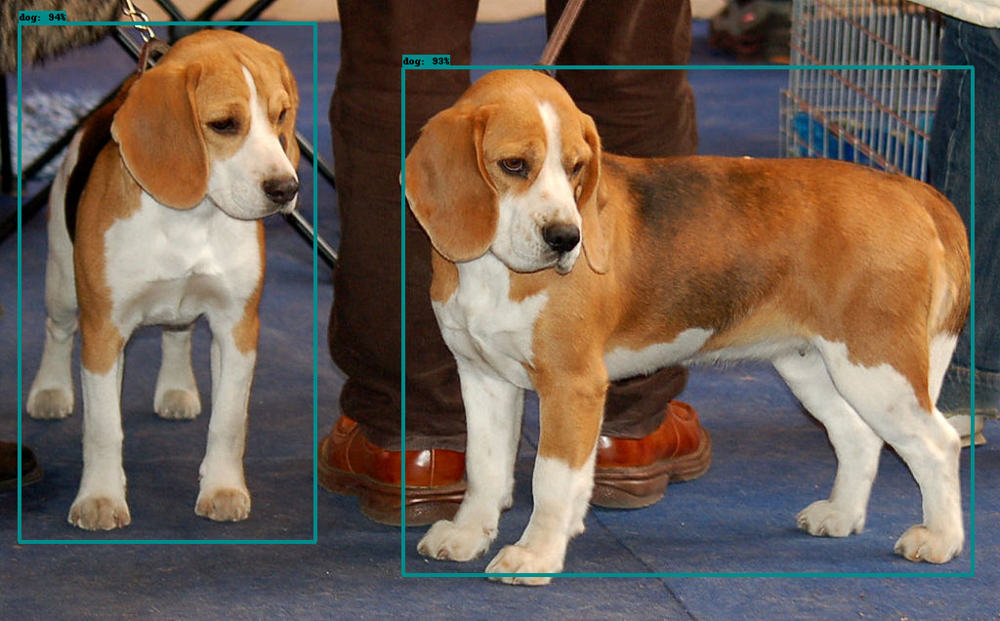

 50%|█████     | 1/2 [00:00<00:00,  2.40it/s]

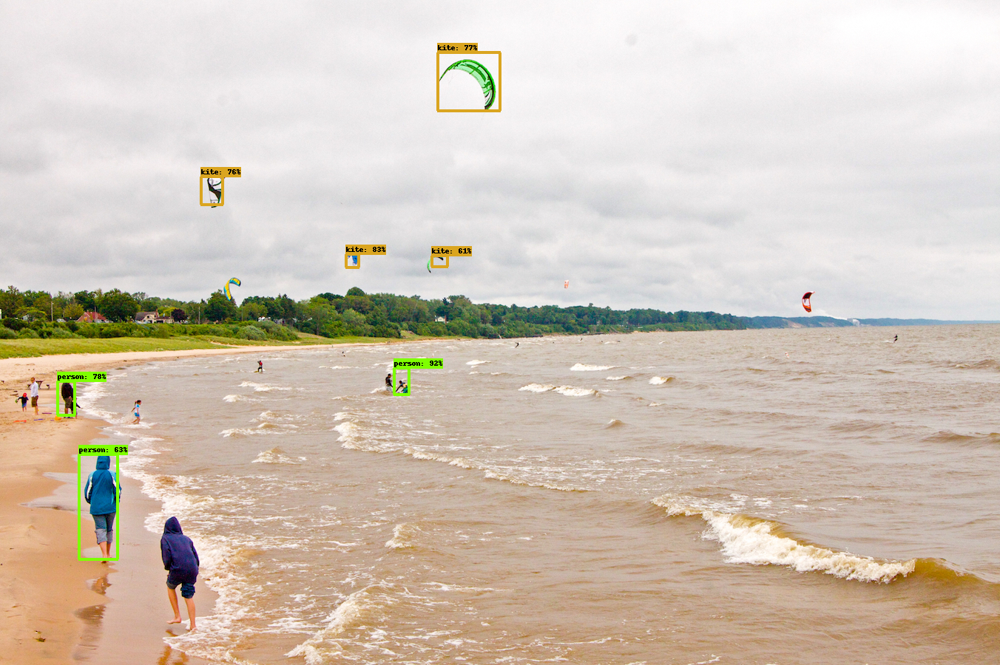

100%|██████████| 2/2 [00:01<00:00,  1.66it/s]


In [97]:
for image_path in tqdm(TEST_IMAGE_PATHS):
  show_inference(detection_model, image_path)


# Fine-tune a pre-trained model on custom data

## Prepare the dataset

We can modularize this cell

In [98]:
duck_train_image_dir = 'object_detection/test_images/ducky/train/'
platypus_train_image_dir = '/content/models/research/object_detection/test_images/platypus/train'
minion_train_image_dir = '/content/models/research/object_detection/test_images/minions/train'

duck_train_images_np = []
platypus_train_images_np = []
minion_train_images_np = []

num_duck_images = len(os.listdir(duck_train_image_dir))
num_platypus_images = len(os.listdir(platypus_train_image_dir))
num_minion_images = len(os.listdir(minion_train_image_dir))

# load ducky train images
for i in range(1, num_duck_images+1):
  image_path = os.path.join(duck_train_image_dir, 'robertducky' + str(i) + '.jpg')
  duck_train_images_np.append(np.array(Image.open(image_path)))
  print(image_path)

# load platypus train images
for i in range(1, num_platypus_images+1):
  image_path = os.path.join(platypus_train_image_dir, 'plat_' + str(i) + '.jpg')
  platypus_train_images_np.append(np.array(Image.open(image_path)))
  print(image_path)

# load minion train images
for i in range(1, num_minion_images+1):
  image_path = os.path.join(minion_train_image_dir, 'minion_' + str(i) + '.jpg')
  minion_train_images_np.append(np.array(Image.open(image_path)))
  print(image_path)

train_images_np = duck_train_images_np + platypus_train_images_np + minion_train_images_np


object_detection/test_images/ducky/train/robertducky1.jpg
object_detection/test_images/ducky/train/robertducky2.jpg
object_detection/test_images/ducky/train/robertducky3.jpg
object_detection/test_images/ducky/train/robertducky4.jpg
object_detection/test_images/ducky/train/robertducky5.jpg
/content/models/research/object_detection/test_images/platypus/train/plat_1.jpg
/content/models/research/object_detection/test_images/platypus/train/plat_2.jpg
/content/models/research/object_detection/test_images/platypus/train/plat_3.jpg
/content/models/research/object_detection/test_images/platypus/train/plat_4.jpg
/content/models/research/object_detection/test_images/platypus/train/plat_5.jpg
/content/models/research/object_detection/test_images/minions/train/minion_1.jpg
/content/models/research/object_detection/test_images/minions/train/minion_2.jpg
/content/models/research/object_detection/test_images/minions/train/minion_3.jpg
/content/models/research/object_detection/test_images/minions/train

## Label dataset's images
Using this tool we set manually the object's coordinates so we can train the model using this images, it's class and coordinates as inputs.

In [63]:
from object_detection.utils import colab_utils

gt_ducky_boxes = []
gt_platypus_boxes = []
gt_minion_boxes = []

colab_utils.annotate(train_images_np, box_storage_pointer=gt_boxes)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

'--boxes array populated--'

<IPython.core.display.Javascript object>

Run the following cell in order to avoid labeling all the images

In [18]:
gt_boxes = [[[0.42623106, 0.58382181, 0.63123106, 0.71746776]],
            [[0.5295644 , 0.58264947, 0.73123106, 0.7116061 ]],
            [[0.4595644 , 0.40679953, 0.6295644 , 0.55099648]],
            [[0.30789773, 0.30128957, 0.65123106, 0.52637749]],
            [[0.2495644 , 0.43845252, 0.48789773, 0.62954279]],
            [[0.26623106, 0.29663825, 0.7795644 , 0.75653408]],
            [[0.29623106, 0.00146699, 0.85789773, 0.8405868 ]],
            [[0.19789773, 0.15625   , 0.67789773, 0.89192708]],
            [[0.03123106, 0.        , 0.9945644 , 0.89814815]],
            [[0.13123106, 0.38      , 0.7345644 , 0.91105263]],
            [[0.05623106, 0.08611111, 0.9695644 , 0.91388889]],
            [[0.05623106, 0.04861631, 0.98289773, 0.81376215]],
            [[0.04123106, 0.13431013, 0.8595644 , 0.89255189]],
            [[3.28977299e-02, 8.81834215e-04, 9.92897730e-01, 9.98236332e-01]],
            [[0.00789773, 0.16470588, 0.97789773, 0.88039216]]),
            [[0.27623106, 0.36444444, 0.99123106, 0.67111111],
              [0.0195644 , 0.00222222, 0.81289773, 0.18666667],
              [0.00623106, 0.25333333, 0.8045644 , 0.45555556],
              [0.0045644 , 0.54222222, 0.79789773, 0.78888889],
              [0.        , 0.83333333, 0.81623106, 1.        ]],
            [[0.        , 0.14125   , 0.9445644 , 0.36375   ],
            [0.30123106, 0.46625   , 0.94623106, 0.79125   ],
            [0.19289773, 0.79625   , 0.9145644 , 1.        ]],
            [[0.0895644 , 0.028     , 0.99289773, 0.336     ],
            [0.41623106, 0.363     , 1.        , 0.761     ],
            [0.03789773, 0.602     , 0.98789773, 0.984     ]]]

In [ ]:
gt_boxes = [np.array(arr) for arr in gt_boxes]
gt_boxes

## Prepare the classes of the data to predict

In [65]:
duck_class_id, platypus_class_id, minion_class_id = 1, 2, 3
num_classes = 3

# Prepare the classes (only 3 in this example)
category_index = {duck_class_id: {'id': duck_class_id, 'name': 'rubber_ducky'}, 
                  platypus_class_id:{'id': platypus_class_id, 'name': 'platypus'},
                  minion_class_id: {'id': minion_class_id, 'name':'minion'}}

train_image_tensors = []
gt_classes_one_hot_tensors = []
gt_box_tensors = []
index = 1 # this index is in charge of changing the classes value (first 5 duckies, next 5 platypuses... )

for (train_image_np, gt_box_np) in zip(train_images_np, gt_boxes):

  train_image_tensors.append(tf.expand_dims(tf.convert_to_tensor(
      train_image_np, dtype=tf.float32), axis=0))
  
  gt_box_tensors.append(tf.convert_to_tensor(gt_box_np, dtype=tf.float32))

  # Hardcoded for this particular case: depending of the number of the image set the class of that image.
  if index <= num_duck_images:
    zero_indexed_groundtruth_classes = tf.convert_to_tensor(np.zeros(shape=[gt_box_np.shape[0]], dtype=np.int32))
  elif index > num_duck_images and index <= (num_platypus_images + num_duck_images):
    zero_indexed_groundtruth_classes = tf.convert_to_tensor(np.zeros(shape=[gt_box_np.shape[0]], dtype=np.int32)+1)
  else:
    zero_indexed_groundtruth_classes = tf.convert_to_tensor(np.zeros(shape=[gt_box_np.shape[0]], dtype=np.int32)+2)

  index +=1
  
  gt_classes_one_hot_tensors.append(tf.one_hot(
      zero_indexed_groundtruth_classes, num_classes))
print('Done prepping data.')

Done prepping data.


In [66]:
len(gt_classes_one_hot_tensors)

18

In [67]:
%matplotlib inline
plt.close()

## Let's just visualize the images as a sanity check

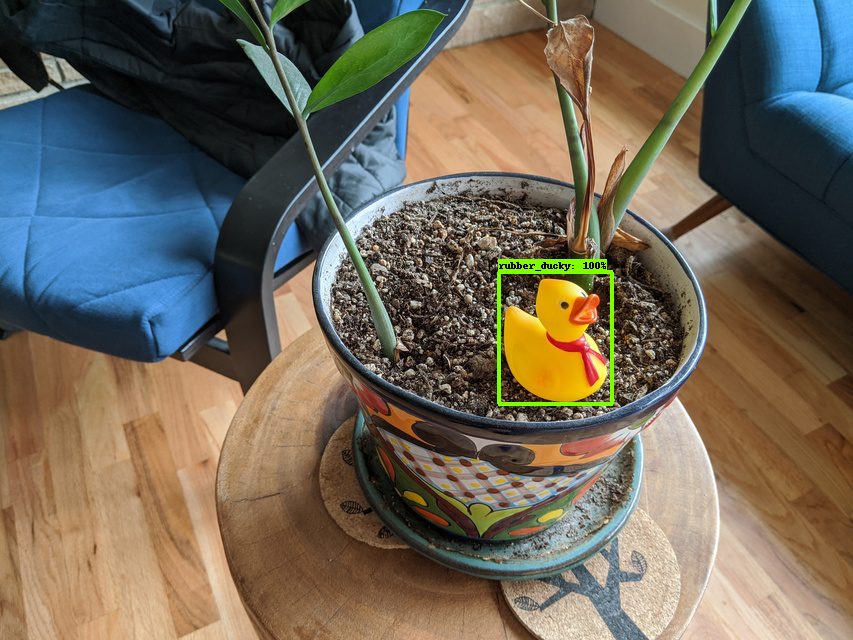

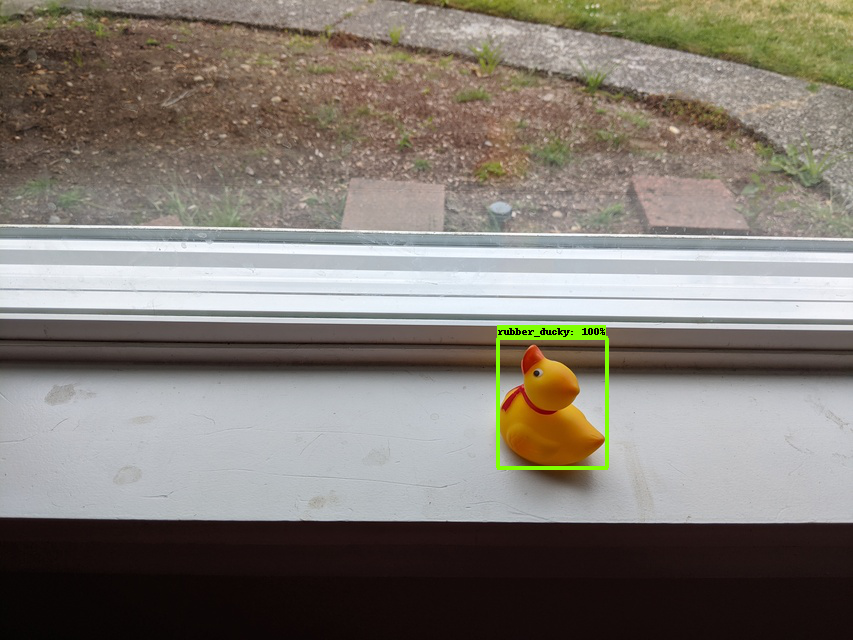

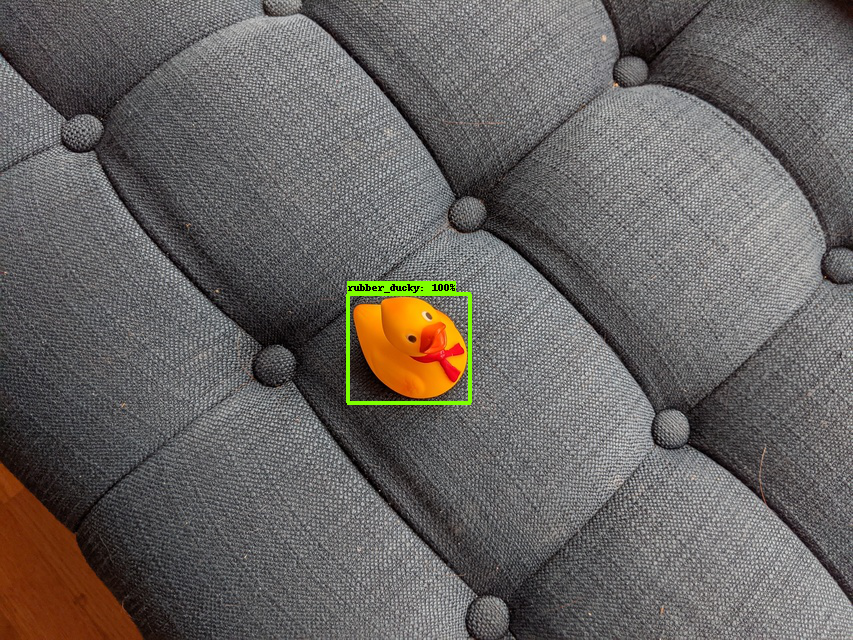

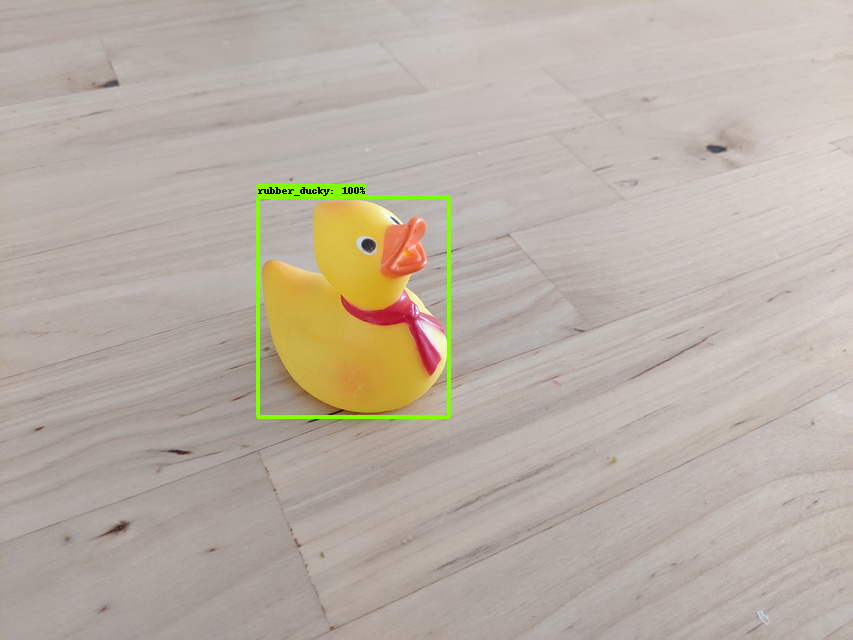

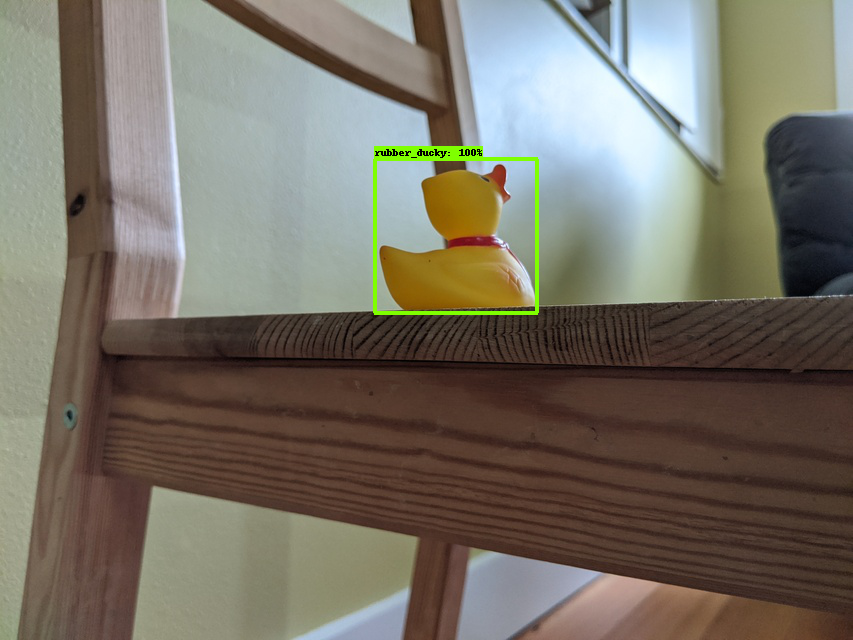

...

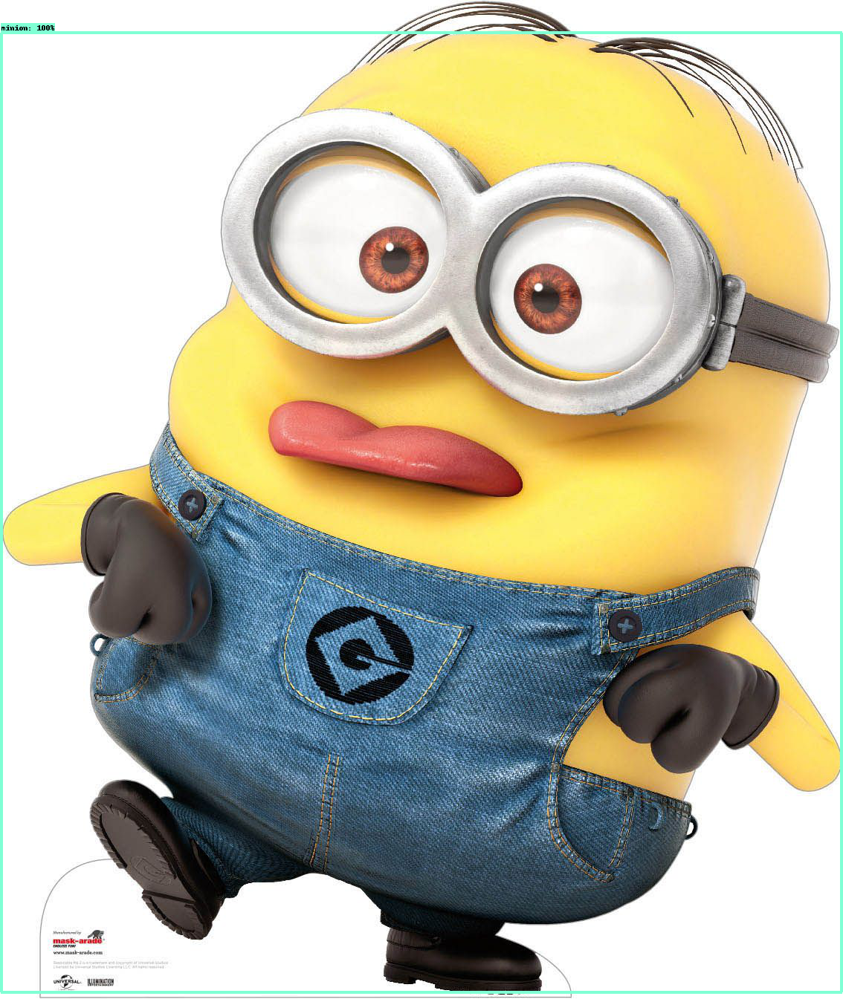

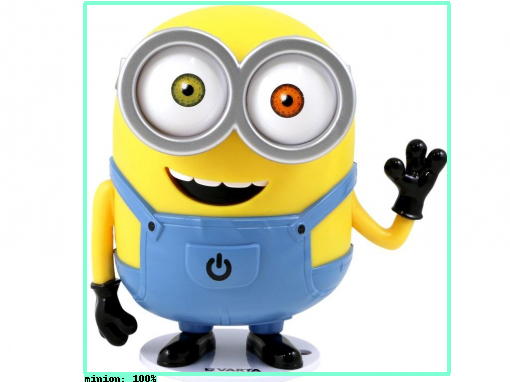

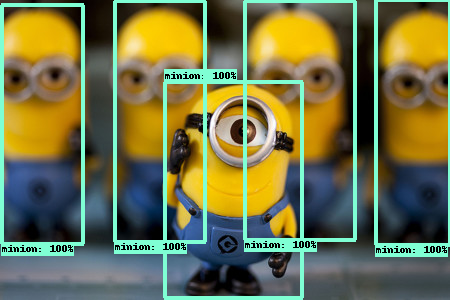

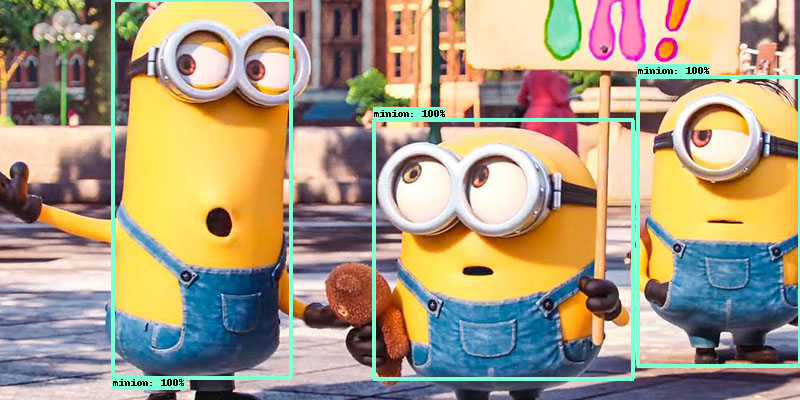

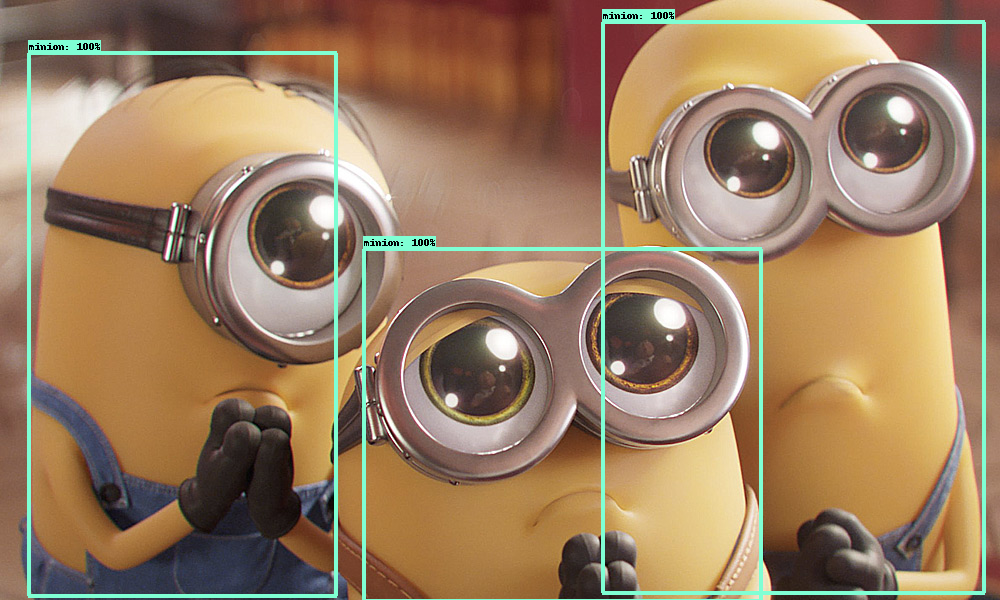

<Figure size 1440x720 with 0 Axes>

In [68]:
fig = plt.figure(figsize=(20, 10))
for idx in range(18):
  if idx < num_duck_images:
    class_index =0
  elif idx >= num_duck_images and idx < (num_platypus_images + num_duck_images):
    class_index =1
  else:
    class_index =2

  dummy_scores = np.ones(gt_boxes[idx].shape[0], dtype=np.float32)  # give boxes a score of 100%

  # plt.subplot(9, 9, idx+1)
  plot_detections(
      train_images_np[idx],
      gt_boxes[idx],
      np.ones(shape=[gt_boxes[idx].shape[0]], dtype=np.int32) + class_index,
      dummy_scores, category_index)
fig.show()

In [69]:
tf.keras.backend.clear_session()



## Getting model's checkpoints




In [43]:
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
!tar -xf ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
%mv ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint /content/models/research/object_detection/test_data/

--2021-01-21 11:27:24--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 172.253.62.128, 2607:f8b0:4004:c07::80
Connecting to download.tensorflow.org (download.tensorflow.org)|172.253.62.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 244817203 (233M) [application/x-tar]
Saving to: ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz’

ssd_resnet50_v1_fpn 100%[===================>] 233.48M   194MB/s    in 1.2s    

2021-01-21 11:27:25 (194 MB/s) - ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz’ saved [244817203/244817203]



In [ ]:
!ls -l models/research/object_detection/test_data/checkpoint/

In [70]:
num_classes = 3

print('Building model and restoring weights for fine-tuning...', flush=True)
pipeline_config = '/content/models/research/object_detection/configs/tf2/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.config'
checkpoint_path = '/content/models/research/object_detection/test_data/checkpoint/ckpt-0'

# Load pipeline config and build a detection model.
#
# Since we are working off of a COCO architecture which predicts 90
# class slots by default, we override the `num_classes` field here to be just
# three (ducky, platypus and minion).

configs = config_util.get_configs_from_pipeline_file(pipeline_config)
model_config = configs['model']
model_config.ssd.num_classes = num_classes
model_config.ssd.freeze_batchnorm = True
ducktection_model = model_builder.build(
      model_config=model_config, is_training=True)

fake_box_predictor = tf.compat.v2.train.Checkpoint(
    _base_tower_layers_for_heads=ducktection_model._box_predictor._base_tower_layers_for_heads,
    # _prediction_heads=ducktection_model._box_predictor._prediction_heads,
    #    (i.e., the classification head that we *will not* restore)
    _box_prediction_head=ducktection_model._box_predictor._box_prediction_head,
    )
fake_model = tf.compat.v2.train.Checkpoint(
          _feature_extractor=ducktection_model._feature_extractor,
          _box_predictor=fake_box_predictor)
ckpt = tf.compat.v2.train.Checkpoint(model=fake_model)
ckpt.restore(checkpoint_path).expect_partial()

# Run model through a dummy image so that variables are created
image, shapes = ducktection_model.preprocess(tf.zeros([1, 640, 640, 3]))
prediction_dict = ducktection_model.predict(image, shapes)
_ = ducktection_model.postprocess(prediction_dict, shapes)
print('Weights restored!')

Building model and restoring weights for fine-tuning...
Weights restored!


## Eager mode custom training loop

In [71]:
import random
# These parameters can be tuned; since our training set has 18 images
# it doesn't make sense to have a much larger batch size, though we could
# fit more examples in memory if we wanted to.
batch_size = 8
learning_rate = 0.01
num_batches = 300

trainable_variables = ducktection_model.trainable_variables
to_fine_tune = []
prefixes_to_train = [
  'WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalBoxHead',
  'WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalClassHead']

for var in trainable_variables:
  if any([var.name.startswith(prefix) for prefix in prefixes_to_train]):
    to_fine_tune.append(var)

# Set up forward + backward pass for a single train step.
def get_model_train_step_function(model, optimizer, vars_to_fine_tune):
  """Get a tf.function for training step."""

  # Use tf.function for a bit of speed.
  # Comment out the tf.function decorator if you want the inside of the
  # function to run eagerly.
  # @tf.function
  def train_step_fn(image_tensors,
                    groundtruth_boxes_list,
                    groundtruth_classes_list):
    """A single training iteration.

    Args:
      image_tensors: A list of [1, height, width, 3] Tensor of type tf.float32.
        Note that the height and width can vary across images, as they are
        reshaped within this function to be 640x640.
      groundtruth_boxes_list: A list of Tensors of shape [N_i, 4] with type
        tf.float32 representing groundtruth boxes for each image in the batch.
      groundtruth_classes_list: A list of Tensors of shape [N_i, num_classes]
        with type tf.float32 representing groundtruth boxes for each image in
        the batch.

    Returns:
      A scalar tensor representing the total loss for the input batch.
    """
    shapes = tf.constant(batch_size * [[640, 640, 3]], dtype=tf.int32)
    model.provide_groundtruth(
        groundtruth_boxes_list=groundtruth_boxes_list,
        groundtruth_classes_list=groundtruth_classes_list)
    with tf.GradientTape() as tape:
      preprocessed_images = tf.concat(
          [ducktection_model.preprocess(image_tensor)[0]
           for image_tensor in image_tensors], axis=0)
      prediction_dict = model.predict(preprocessed_images, shapes)
      losses_dict = model.loss(prediction_dict, shapes)
      total_loss = losses_dict['Loss/localization_loss'] + losses_dict['Loss/classification_loss']
      gradients = tape.gradient(total_loss, vars_to_fine_tune)
      optimizer.apply_gradients(zip(gradients, vars_to_fine_tune))
    return total_loss

  return train_step_fn

optimizer = tf.keras.optimizers.SGD(learning_rate=learning_rate, momentum=0.9)
train_step_fn = get_model_train_step_function(
    ducktection_model, optimizer, to_fine_tune)

print('Start fine-tuning!', flush=True)
for idx in range(num_batches):

  # Grab keys for a random subset of examples
  all_keys = list(range(len(train_images_np)))
  random.shuffle(all_keys)
  example_keys = all_keys[:batch_size]

  # Note that we do not do data augmentation in this demo.
  gt_boxes_list = [gt_box_tensors[key] for key in example_keys]
  gt_classes_list = [gt_classes_one_hot_tensors[key] for key in example_keys]
  image_tensors = [train_image_tensors[key] for key in example_keys]

  # Training step (forward pass + backwards pass)
  total_loss = train_step_fn(image_tensors, gt_boxes_list, gt_classes_list)

  if idx % 10 == 0:
    print('batch ' + str(idx) + ' of ' + str(num_batches)
    + ', loss=' +  str(total_loss.numpy()), flush=True)

print('Done fine-tuning!')

Start fine-tuning!
batch 0 of 300, loss=1.2234732
batch 10 of 300, loss=0.39151418
batch 20 of 300, loss=0.13604465
batch 30 of 300, loss=0.0990483
batch 40 of 300, loss=0.12032158
batch 50 of 300, loss=0.08756805
batch 60 of 300, loss=0.08347088
batch 70 of 300, loss=0.052878812
batch 80 of 300, loss=0.050204262
batch 90 of 300, loss=0.044705182
batch 100 of 300, loss=0.036652345
batch 110 of 300, loss=0.027317502
batch 120 of 300, loss=0.023920555
batch 130 of 300, loss=0.029009111
batch 140 of 300, loss=0.03213577
batch 150 of 300, loss=0.030653374
batch 160 of 300, loss=0.023069331
batch 170 of 300, loss=0.021106293
batch 180 of 300, loss=0.022003522
batch 190 of 300, loss=0.018209845
batch 200 of 300, loss=0.01557629
batch 210 of 300, loss=0.016561704
batch 220 of 300, loss=0.013350751
batch 230 of 300, loss=0.0157271
batch 240 of 300, loss=0.016502654
batch 250 of 300, loss=0.013401135
batch 260 of 300, loss=0.010602275
batch 270 of 300, loss=0.013017917
batch 280 of 300, loss=0.

## Load test images and run inference with new model

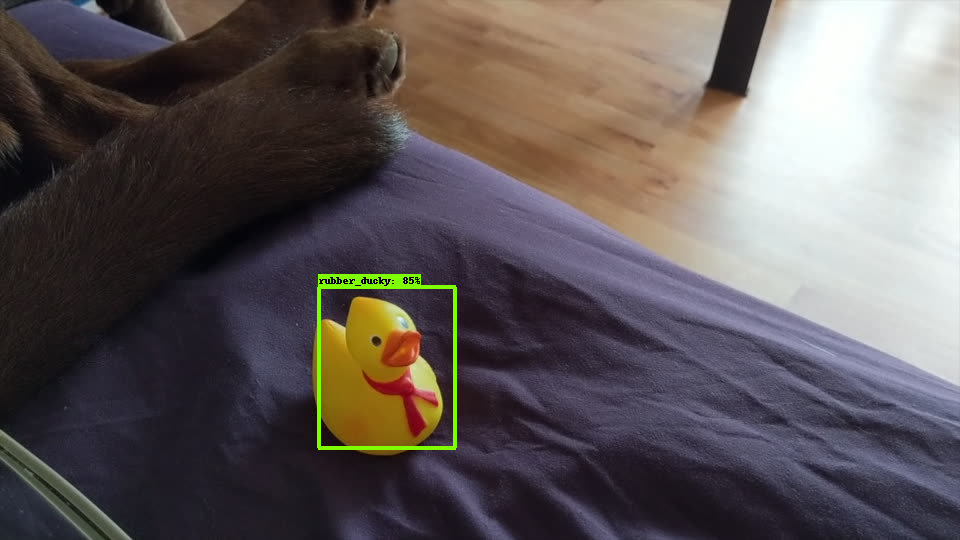

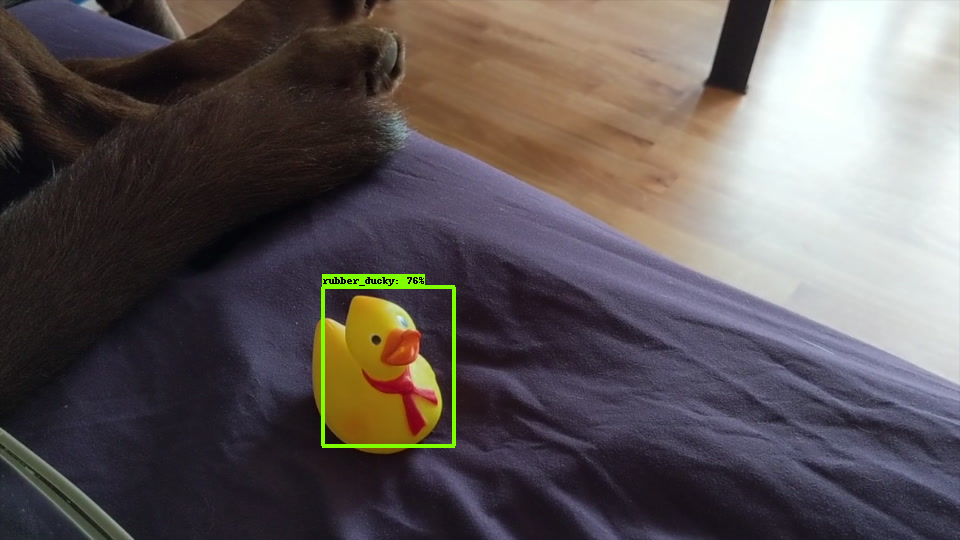

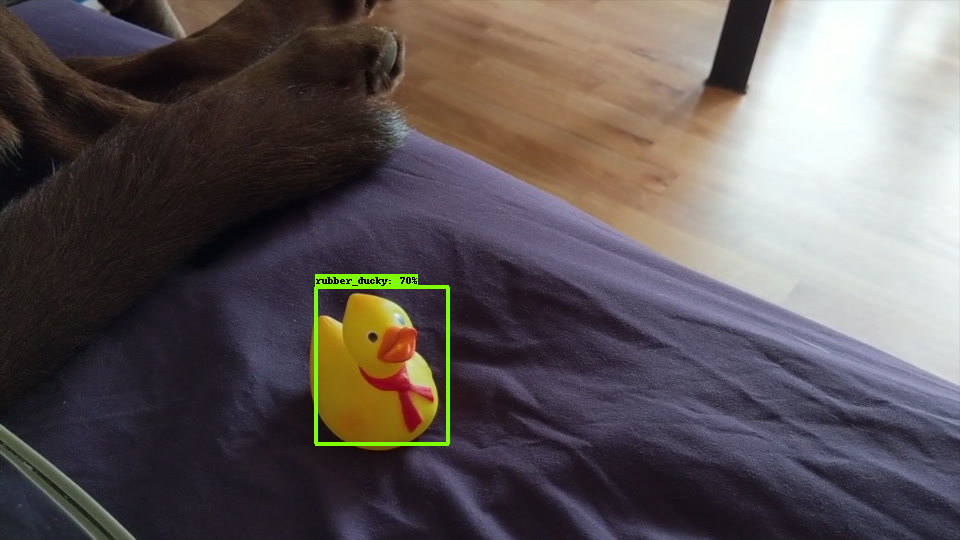

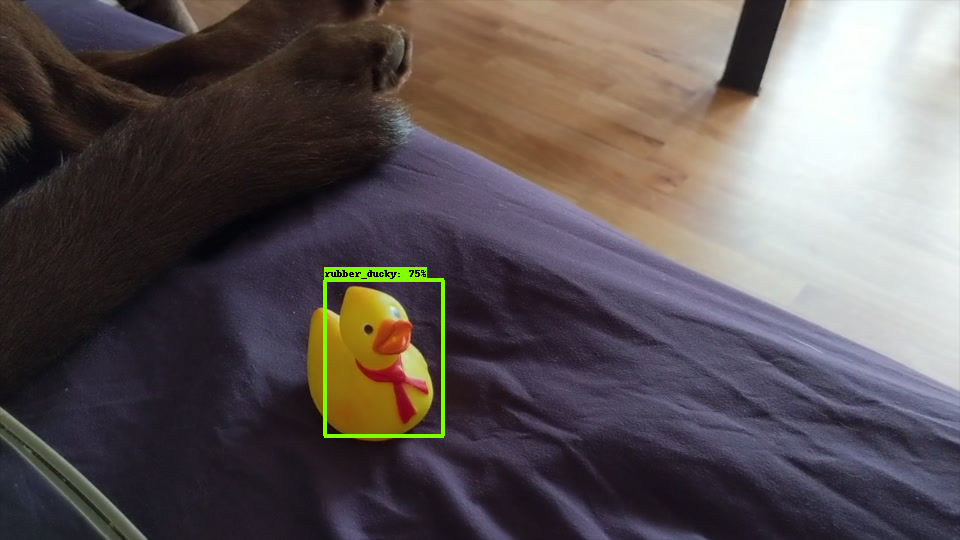

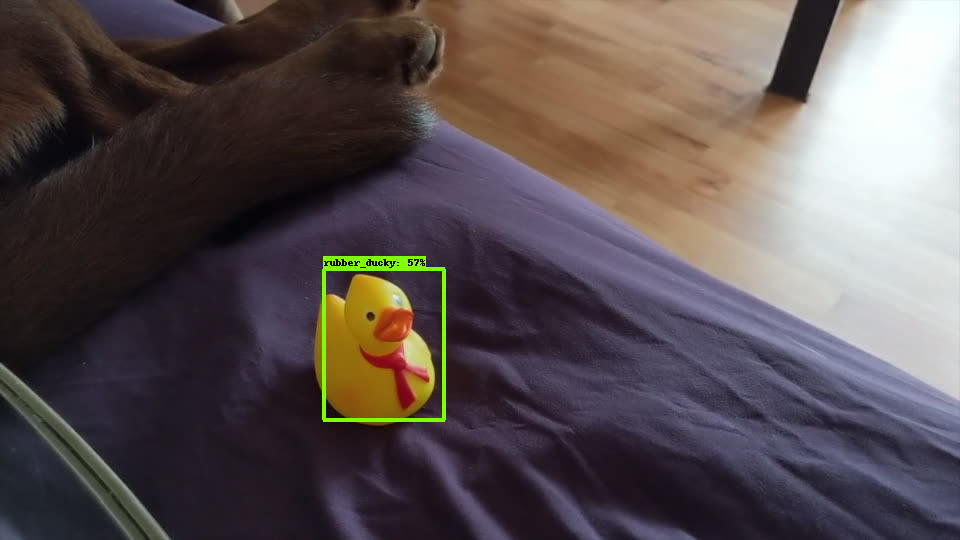

...

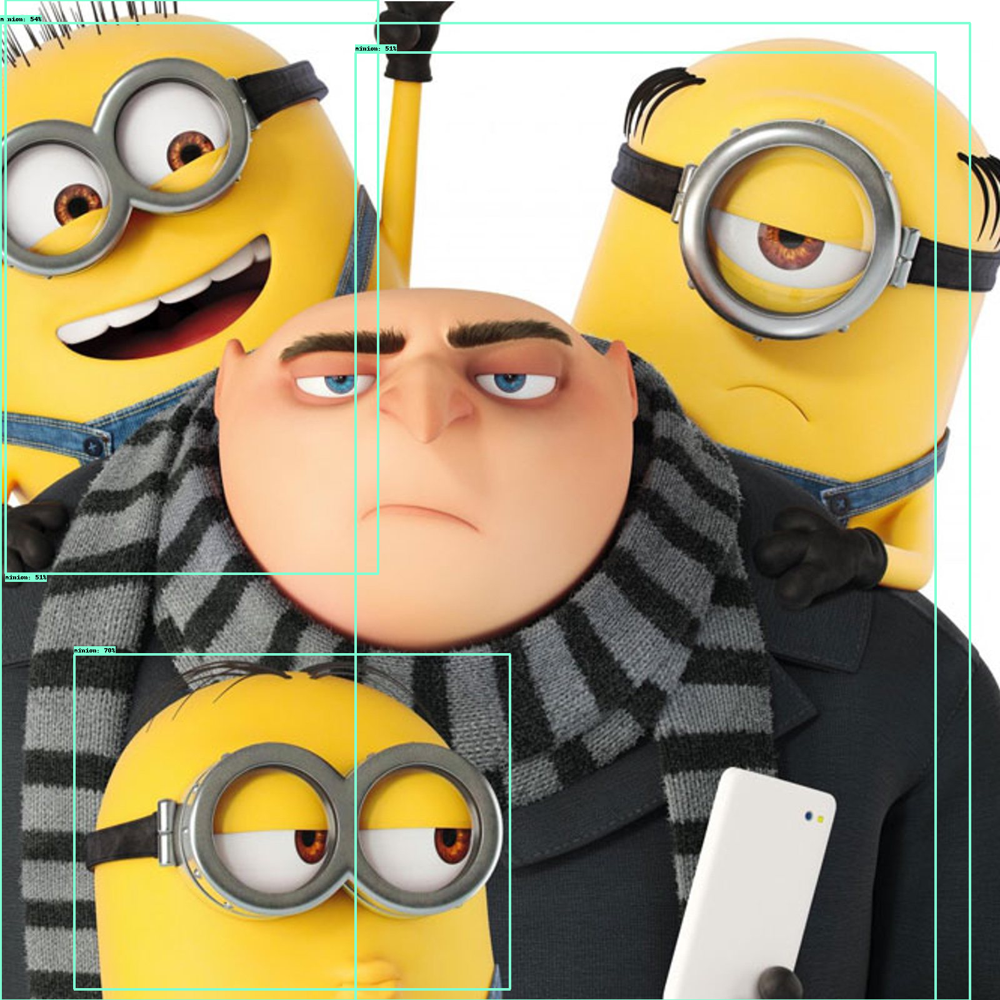

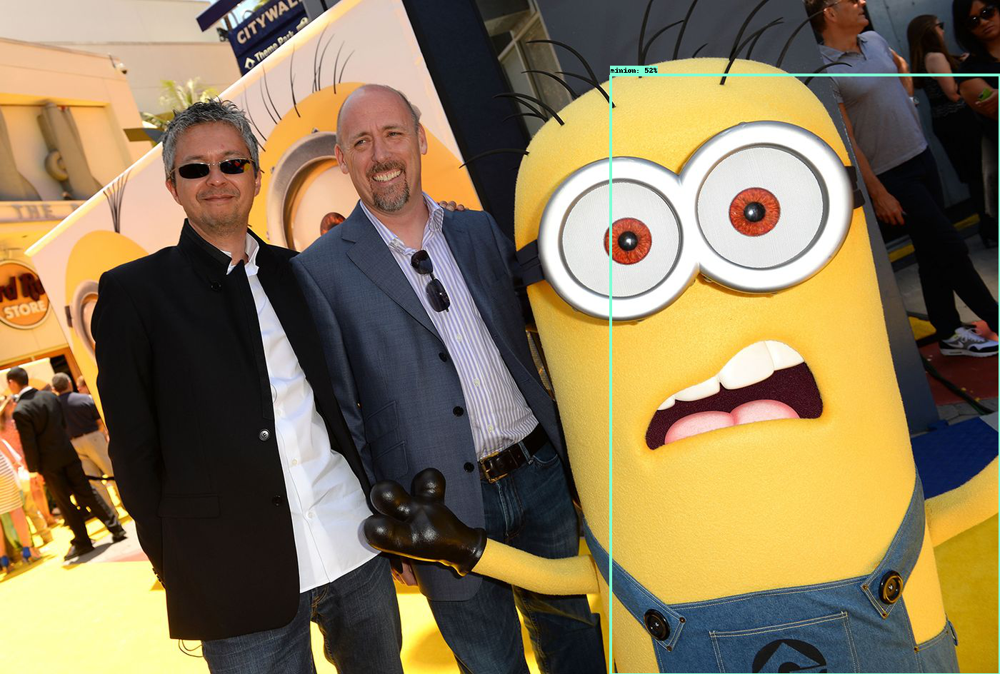

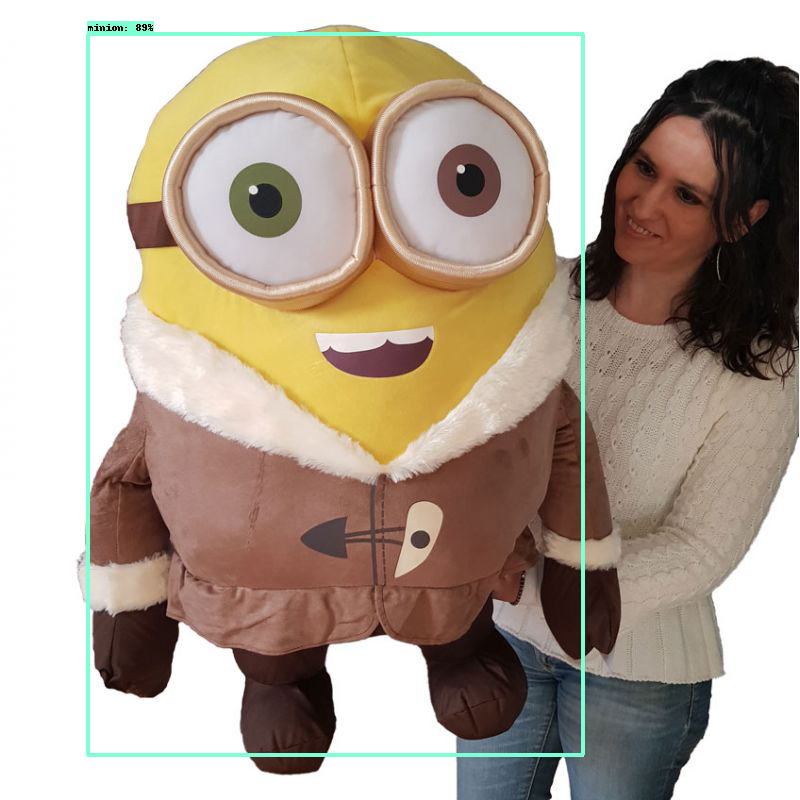

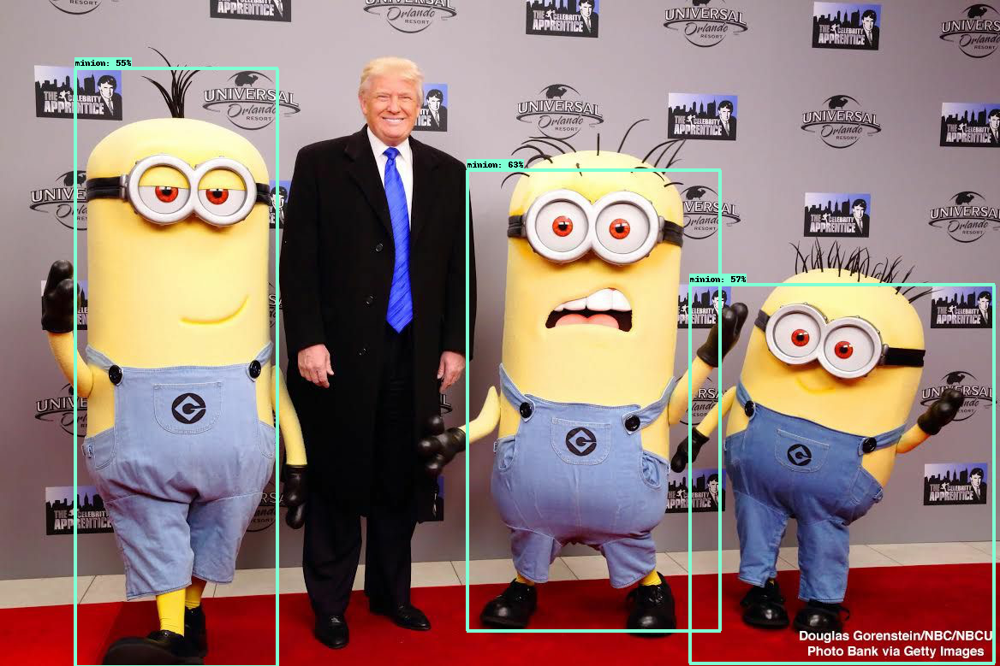

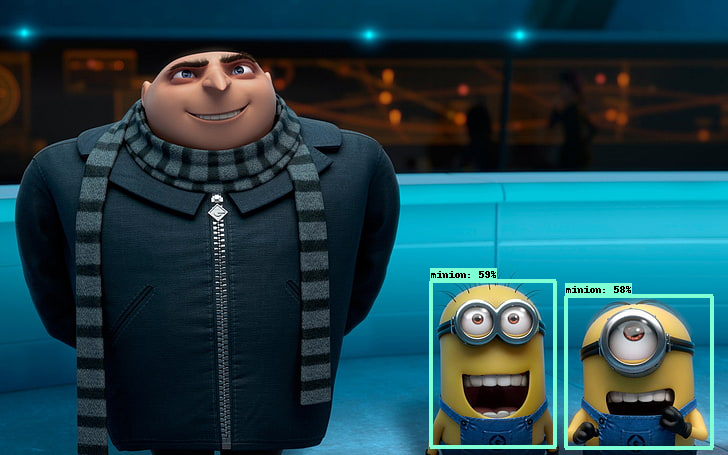

In [79]:
duck_test_image_dir = 'object_detection/test_images/ducky/test/'
platypus_test_image_dir = 'object_detection/test_images/platypus/test/'
minion_test_image_dir = 'object_detection/test_images/minions/test/'

test_images_np = []
for i in range(1, 10):
  image_path = os.path.join(duck_test_image_dir, 'out' + str(i) + '.jpg')
  test_images_np.append(np.expand_dims(
      load_image_into_numpy_array(image_path), axis=0))

for img in os.listdir(platypus_test_image_dir):
  test_images_np.append(np.expand_dims(
      load_image_into_numpy_array(os.path.join(platypus_test_image_dir, img)), axis=0))
  
for img in os.listdir(minion_test_image_dir):
  test_images_np.append(np.expand_dims(
      load_image_into_numpy_array(os.path.join(minion_test_image_dir, img)), axis=0))
  
# Again, uncomment this decorator if you want to run inference eagerly
@tf.function
def detect(input_tensor):
  """Run detection on an input image.

  Args:
    input_tensor: A [1, height, width, 3] Tensor of type tf.float32.
      Note that height and width can be anything since the image will be
      immediately resized according to the needs of the model within this
      function.

  Returns:
    A dict containing 3 Tensors (`detection_boxes`, `detection_classes`,
      and `detection_scores`).
  """
  preprocessed_image, shapes = ducktection_model.preprocess(input_tensor)
  prediction_dict = ducktection_model.predict(preprocessed_image, shapes)
  return ducktection_model.postprocess(prediction_dict, shapes)

# Note that the first frame will trigger tracing of the tf.function, which will
# take some time, after which inference should be fast.

label_id_offset = 1
for i in range(len(test_images_np)):
  input_tensor = tf.convert_to_tensor(test_images_np[i], dtype=tf.float32)
  detections = detect(input_tensor)

  plot_detections(
      test_images_np[i][0],
      detections['detection_boxes'][0].numpy(),
      detections['detection_classes'][0].numpy().astype(np.uint32)
      + label_id_offset,
      detections['detection_scores'][0].numpy(),
      category_index, 
      min_score_threshold = 0.45,
      figsize=(15, 20), image_name="gif_frame_" + ('%02d' % i) + ".jpg")
  

  